<a href="https://colab.research.google.com/github/Tasrina18/ASD_classification---Thesis/blob/main/fc_Matrix%26Brain_Plots.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install --upgrade nilearn

from nilearn.datasets import fetch_abide_pcp
ASD = fetch_abide_pcp(derivatives = ['rois_cc400'], pipeline = 'cpac', DX_GROUP = 1, quality_checked = False)
TDC = fetch_abide_pcp(derivatives = ['rois_cc400'], pipeline = 'cpac', DX_GROUP = 2, quality_checked = False)
ASS = fetch_abide_pcp(derivatives = ['rois_cc400'], pipeline = 'cpac', DSM_IV_TR=[2], quality_checked = False)
PDD =fetch_abide_pcp(derivatives = ['rois_cc400'], pipeline = 'cpac', DSM_IV_TR=[3], quality_checked = False)


In [ ]:
y = ASD.phenotypic['DX_GROUP']
y[y==2] = 0

In [ ]:
import pandas as pd
labels = pd.read_csv('CC400_ROI_labels.csv')
atlas_filename = 'cc400_roi_atlas.nii.gz'



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
ASD =  data[data['DX_GROUP']==1]['rois_cc400'] #505
TD = data[data['DX_GROUP']==2]['rois_cc400'] #530

NameError: name 'data' is not defined

In [ ]:
coordinates = plotting.find_parcellation_cut_coords(labels_img=atlas_filename)

In [ ]:
#for printing one connectivity matrix
import numpy as np
from nilearn import plotting
import matplotlib.pyplot as plt
from nilearn.connectome import ConnectivityMeasure
conn_est = ConnectivityMeasure(kind = 'correlation')
ASD_conn_matrices = conn_est.fit_transform(ASD.rois_cc400)
TDC_conn_matrices = conn_est.fit_transform(TDC.rois_cc400)
ASS_conn_matrices =  conn_est.fit_transform(ASS.rois_cc400)
PDD_conn_matrices =  conn_est.fit_transform(PDD.rois_cc400)


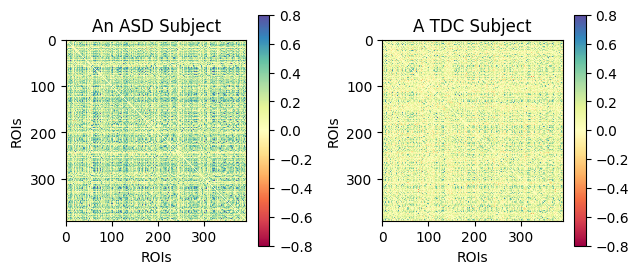

In [ ]:
import matplotlib.pyplot as plt
import numpy as np


ASDmtd = ASD_conn_matrices[0]
np.fill_diagonal(ASDmtd, 0)
TDCmtd = TDC_conn_matrices[0]
np.fill_diagonal(TDCmtd, 0)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))

# heatmap to visualize the connectivity matrix for ASD
im = ax1.imshow(ASDmtd, cmap='Spectral', vmin=-0.8, vmax=0.8, interpolation='none')
cbar = fig.colorbar(im, ax=ax1)
ax1.set_title('An ASD Subject')
ax1.set_xlabel('ROIs')
ax1.set_ylabel('ROIs')

# heatmap to visualize the connectivity matrix for TDC
im1 = ax2.imshow(TDCmtd, cmap='Spectral', vmin=-0.8, vmax=0.8, interpolation='none')
cbar1 = fig.colorbar(im1, ax=ax2)
ax2.set_title('A TDC Subject')
ax2.set_xlabel('ROIs')
ax2.set_ylabel('ROIs')
plt.subplots_adjust(wspace=0.4)
plt.show()





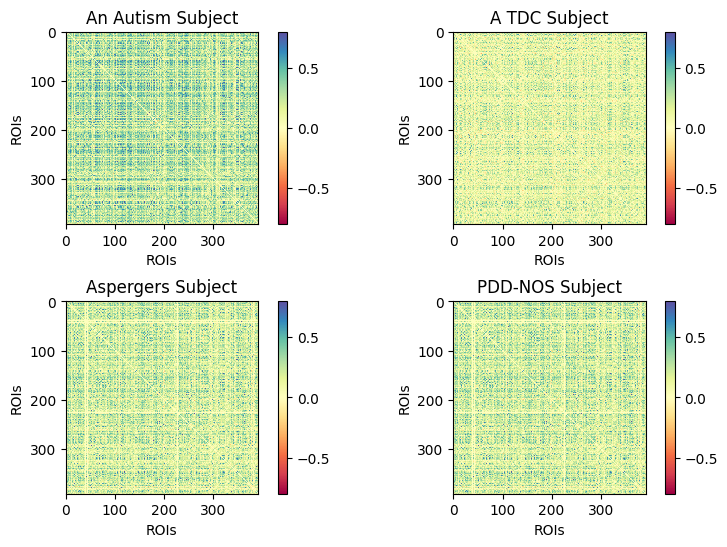

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

ASDmtd = ASD_conn_matrices[0]
np.fill_diagonal(ASDmtd, 0)
TDCmtd = TDC_conn_matrices[0]
np.fill_diagonal(TDCmtd, 0)
ASSmtd = ASS_conn_matrices[0]
np.fill_diagonal(ASSmtd, 0)
PDDmtd = PDD_conn_matrices[7]
np.fill_diagonal(PDDmtd, 0)

fig, axs = plt.subplots(2, 2, figsize=(10, 6))

# heatmap to visualize the connectivity matrix for ASD
im = axs[0, 0].imshow(ASDmtd, cmap='Spectral', vmin=-0.8, vmax=0.8, interpolation='none')
cbar = fig.colorbar(im, ax=axs[0, 0])
axs[0, 0].set_title('An Autism Subject')
axs[0, 0].set_xlabel('ROIs')
axs[0, 0].set_ylabel('ROIs')

# heatmap to visualize the connectivity matrix for TDC
im1 = axs[0, 1].imshow(TDCmtd, cmap='Spectral', vmin=-0.8, vmax=0.8, interpolation='none')
cbar1 = fig.colorbar(im1, ax=axs[0, 1])
axs[0, 1].set_title('A TDC Subject')
axs[0, 1].set_xlabel('ROIs')
axs[0, 1].set_ylabel('ROIs')

# heatmap to visualize the connectivity matrix for Aspergers
im2 = axs[1, 0].imshow(ASSmtd, cmap='Spectral', vmin=-0.8, vmax=0.8, interpolation='none')
cbar1 = fig.colorbar(im2, ax=axs[1, 0])
axs[1, 0].set_title('Aspergers Subject')
axs[1, 0].set_xlabel('ROIs')
axs[1, 0].set_ylabel('ROIs')

# heatmap to visualize the connectivity matrix for PDD NOS
im3 = axs[1, 1].imshow(ASSmtd, cmap='Spectral', vmin=-0.8, vmax=0.8, interpolation='none')
cbar1 = fig.colorbar(im3, ax=axs[1, 1])
axs[1, 1].set_title('PDD-NOS Subject')
axs[1, 1].set_xlabel('ROIs')
axs[1, 1].set_ylabel('ROIs')

plt.subplots_adjust(wspace=0, hspace=0.4)


plt.show()


In [ ]:

plotting.view_connectome(ASDmtd, edge_threshold=0.2,
                         node_coords=coordinates)



In [ ]:

plotting.view_connectome(ASSmtd, edge_threshold=0.2,
                         node_coords=coordinates)

In [ ]:

plotting.view_connectome(PDDmtd, edge_threshold=0.2,
                         node_coords=coordinates)

In [ ]:
plotting.view_connectome(TDCmtd, edge_threshold=0.2,
                         node_coords=coordinates)


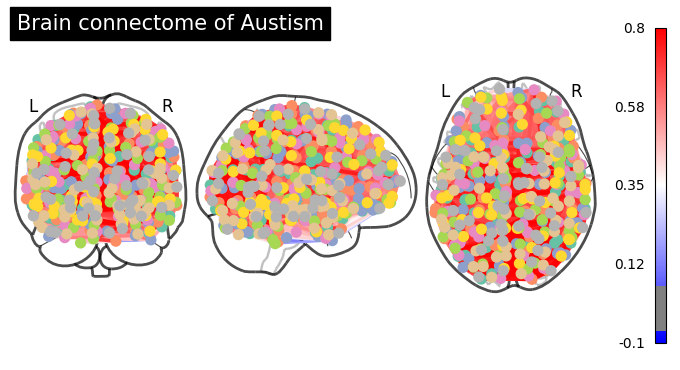

In [ ]:
plotting.plot_connectome(ASDmtd, coordinates, edge_threshold="10%",
                         title='Brain connectome of Austism',edge_vmax=0.8,edge_vmin=-0.1, colorbar =True)